In [4]:
import cv2
import os
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import robotdatapy as rdp # 1.0.3

# scipy rotation matrix
import scipy as sp

In [3]:
# Hard-coded paths (you can modify these if desired)
# video_file = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/videos/DJI_0111.mp4"
video_file = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/videos/DJI_0111_rviz.mp4"

# output_folder = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111"
output_folder = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz"

video_path = Path(video_file)
output_path = Path(output_folder)

sample_rate_input = 1
start_time_input = 10.0
end_time_input = 28.0

# Check if the video file exists
if not video_path.exists():
    raise FileNotFoundError(f"Video file {video_path} does not exist!")

# Create the output folder if it doesn't exist
output_path.mkdir(parents=True, exist_ok=True)

# Prompt for sample rate: extract every nth frame (default: 5)
sample_rate = int(sample_rate_input) if sample_rate_input else 5

# Prompt for start and end times (in seconds)
start_time = float(start_time_input) if start_time_input else 0.0

end_time = float(end_time_input) if end_time_input and float(end_time_input) > 0 else 0.0

# Open the video file
cap = cv2.VideoCapture(str(video_path))
if not cap.isOpened():
    raise IOError("Error opening video file.")

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = cap.get(cv2.CAP_PROP_FRAME_COUNT)

# Calculate start and end frame numbers
start_frame = int(start_time * fps)
if end_time > 0:
    end_frame = int(end_time * fps)
    if end_frame > total_frames:
        end_frame = int(total_frames) - 1
else:
    end_frame = int(total_frames) - 1

# Set the video to start frame
cap.set(cv2.CAP_PROP_POS_FRAMES, start_frame)
print(f"Extracting frames from {start_time:.2f}s (frame {start_frame}) to {end_time if end_time > 0 else 'end'} (frame {end_frame}).")

saved_frame_count = 0
current_frame = start_frame

while current_frame <= end_frame:
    ret, frame = cap.read()
    if not ret:
        break  # End of video or cannot read the frame
    
    # Save the frame if it matches the sample rate criteria
    if (current_frame - start_frame) % sample_rate == 0:
        saved_frame_count += 1
        output_filename = output_path / f"frame_{saved_frame_count:04d}.png"
        cv2.imwrite(str(output_filename), frame)
        print(f"Saved {output_filename}")
    
    current_frame += 1

cap.release()
print(f"Extraction complete! {saved_frame_count} frames saved.")


Extracting frames from 10.00s (frame 150) to 28.0 (frame 420).
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0001.png
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0002.png
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0003.png
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0004.png
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0005.png
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0006.png
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0007.png
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0008.png
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0009.png
Saved /media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/fr

KeyboardInterrupt: 

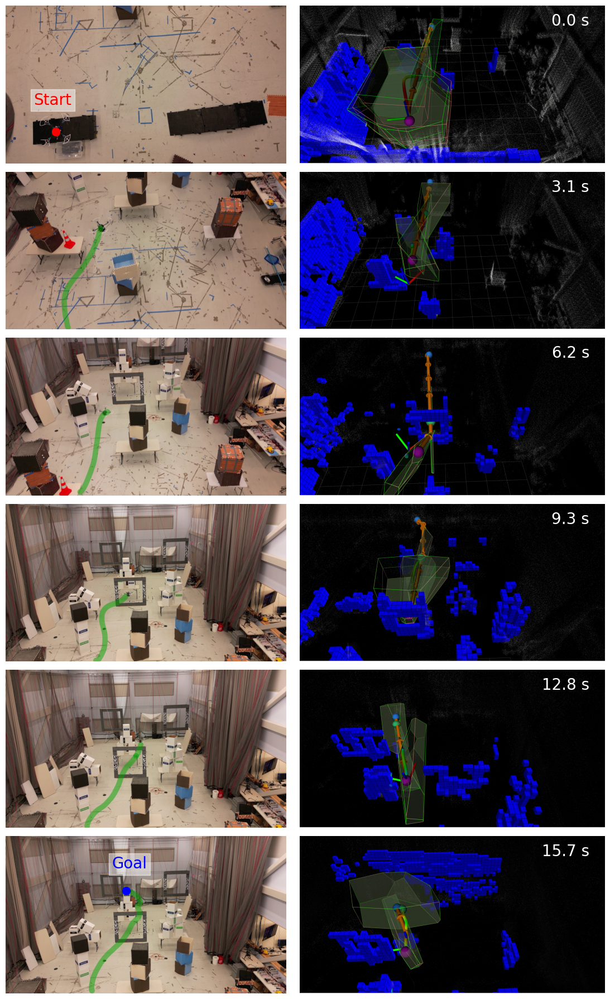

In [7]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Prompt for input and output folder paths
output_folder = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/"
output_path = Path(output_folder)
output_path.mkdir(parents=True, exist_ok=True)

images = [
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111/with_path/frame_0010-1.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0035.png",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111/with_path/frame_0010-2.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0081.png",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111/with_path/frame_0010-3.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0129.png",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111/with_path/frame_0010-4.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0175.png",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111/with_path/frame_0010-5.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0227.png",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111/with_path/frame_0010-6.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_rviz/frame_0271.png",
]

time_interval = (end_time_input - start_time_input) / 271 # 271 frames in total

time_texts = [f"{(35 - 35) * time_interval:.1f} s",
                f"{(81 - 35) * time_interval:.1f} s",
                f"{(129 - 35) * time_interval:.1f} s",
                f"{(175 - 35) * time_interval:.1f} s",
                f"{(227 - 35) * time_interval:.1f} s",
                f"{(271 - 35) * time_interval:.1f} s"]

# Create a figure with 6 rows and 2 columns
fig = plt.figure(figsize=(11.5, 18))
gs = gridspec.GridSpec(6, 2, height_ratios=[1, 1, 1, 1, 1, 1], width_ratios=[1.6, 2])

# Plot each image in the grid
for idx in range(len(images)):

    img = mpimg.imread(str(images[idx]))
    ax = fig.add_subplot(gs[idx // 2, idx % 2])
    
    if idx == 0:
        # Add a dot to indicate the start point
        ax.scatter(0.18, 0.2, s=100, c='red', marker='o', transform=ax.transAxes)
        # add a red text "start point"
        ax.text(0.1, 0.4, "Start",
                ha='left', va='center', transform=ax.transAxes,
                bbox = dict(facecolor='white', alpha=0.5, edgecolor='white'),
                fontsize=20, color='red')

    if idx == len(images) - 2:
        # Add a dot to indicate the end point
        ax.scatter(0.43, 0.65, s=100, c='blue', marker='o', transform=ax.transAxes)
        # add a blue text "end point"
        ax.text(0.38, 0.82, "Goal",
                ha='left', va='center', transform=ax.transAxes,
                bbox = dict(facecolor='white', alpha=0.5, edgecolor='white'),
                fontsize=20, color='blue')

    if idx % 2 == 1:
        # right images (rviz) need to be cropped
        img = img[100:img.shape[0] - 100, 50:img.shape[1] - 50]
        # add white text of time stamp
        ax.text(0.95, 0.9, time_texts[idx // 2], 
                     ha='right', va='center', transform=ax.transAxes, 
                     fontsize=20, color='white')
        
        
    ax.imshow(img)
    ax.axis('off')

plt.tight_layout()

# Define the path for the composite image and save it
# composite_file = output_path / "DJI_0111_composite_image.png"
plt.savefig("/home/kkondo/paper_writing/DYNUS_paper/figures/hardware/uav_static/DJI_0111_composite_image.png", bbox_inches='tight')


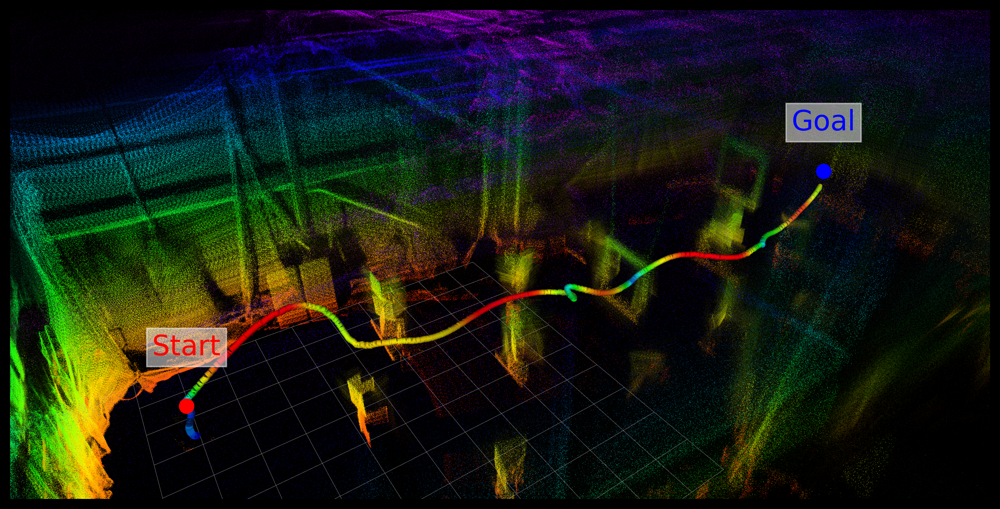

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

plt.style.use('dark_background')

# Prompt for input and output folder paths
input_image = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/DJI_0111_path_pointcloud/uav_hw_num_2_1.png"
output_folder = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/static/images/"
output_path = Path(output_folder)
output_path.mkdir(parents=True, exist_ok=True)

# Create a figure
fig, ax = plt.subplots(figsize=(10, 10), dpi=500)
    
# Add a dot to indicate the start point
ax.scatter(0.18, 0.19, s=100, c='red', marker='o', transform=ax.transAxes)
# add a red text "start point"
ax.text(0.18, 0.31, "Start",
        ha='center', va='center', transform=ax.transAxes,
        bbox = dict(facecolor='white', alpha=0.5, edgecolor='white'),
        fontsize=20, color='red')

# Add a dot to indicate the end point
ax.scatter(0.83, 0.65, s=100, c='blue', marker='o', transform=ax.transAxes)
# add a blue text "end point"
ax.text(0.83, 0.77, "Goal",
        ha='center', va='center', transform=ax.transAxes,
        bbox = dict(facecolor='white', alpha=0.5, edgecolor='white'),
        fontsize=20, color='blue')

# right images (rviz) need to be cropped
# Read the image
img = mpimg.imread(input_image)
img = img[150:img.shape[0] - 150, 50:img.shape[1] - 50]
# Display the image
ax.imshow(img)
ax.axis('off')

plt.tight_layout()

# Define the path for the composite image and save it
plt.savefig(output_folder + "DJI_0111_path_pointcloud3_annotated.png", bbox_inches='tight')
plt.savefig("/home/kkondo/paper_writing/DYNUS_paper/figures/hardware/uav_static/DJI_0111_path_pointcloud3_annotated.png", bbox_inches='tight')
# plt.show()